In [1]:
import pandas as pd

HD6H_ctrl = pd.read_csv("HD6H_ctrl.csv")
HD6H_ctrl = HD6H_ctrl.rename(columns={"Unnamed: 0": "Gene"})
HD6H_ctrl.head()

,Gene,logFC,logCPM,PValue,padj
0,TraesCS1A02G000100,-1.976864,1.379010,0.050924,0.069376
1,TraesCS1A02G000200,-5.044694,6.599056,0.000032,0.000065
2,TraesCS1A02G000300,-1.439511,4.186677,0.064964,0.087016
3,TraesCS1A02G000400,-1.818695,10.606100,0.038202,0.053079
4,TraesCS1A02G000700,-7.533498,-2.660845,0.000001,0.000002


In [2]:
from numpy.ma.core import log10

def determineExp(logFC, pAdj):
  if logFC < -5 and pAdj < 0.001:
    return "downregulated"
  elif logFC > 5 and pAdj < 0.001:
    return "upregulated"
  else:
    return "not significant"

HD6H_ctrl["neg_log_p_value"] = [-log10(padj) for padj in HD6H_ctrl["padj"].values]
HD6H_ctrl["Change in Gene Expression"] = HD6H_ctrl.apply(lambda row : determineExp(row['logFC'], row['padj']), axis = 1)
HD6H_ctrl.head()

,Gene,logFC,logCPM,PValue,padj,neg_log_p_value,Change in Gene Expression
0,TraesCS1A02G000100,-1.976864,1.379010,0.050924,0.069376,1.15879,not significant
1,TraesCS1A02G000200,-5.044694,6.599056,0.000032,0.000065,4.185414,downregulated
2,TraesCS1A02G000300,-1.439511,4.186677,0.064964,0.087016,1.060399,not significant
3,TraesCS1A02G000400,-1.818695,10.606100,0.038202,0.053079,1.275078,not significant
4,TraesCS1A02G000700,-7.533498,-2.660845,0.000001,0.000002,5.623071,downregulated


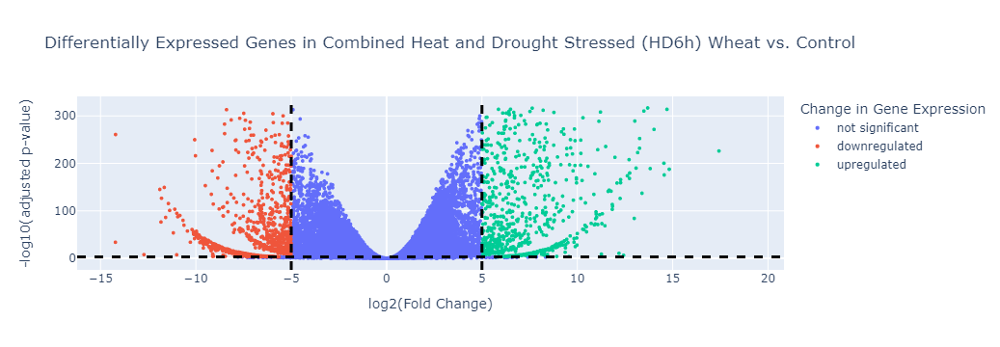

In [3]:
import plotly.express as px
fig = px.scatter(HD6H_ctrl, x='logFC', y='neg_log_p_value', color="Change in Gene Expression",
                 hover_data={
                     'Gene':True,
                     'logFC': False,
                     'logCPM': False,
                     'PValue': False,
                     'Change in Gene Expression': False,
                     'neg_log_p_value': False},
                 title='Differentially Expressed Genes in Combined Heat and Drought Stressed (HD6h) Wheat vs. Control', 
                 labels={
                     'logFC': 'log2(Fold Change)', 
                     'neg_log_p_value': '-log10(adjusted p-value)'})

fig.add_hline(y=-log10(0.001), line_width=3, line_dash="dash", line_color="black")
fig.add_vline(x=-5, line_width=3, line_dash="dash", line_color="black")
fig.add_vline(x=5, line_width=3, line_dash="dash", line_color="black")

fig.update_layout(
    title_x=0.45,
    hoverlabel=dict(
        font_size=15,
        font_family='Calibri'
    )
)

fig.update_traces(marker=dict(size=4),
                  selector=dict(mode='markers'))

fig.show()